## Pretrained Model Resnet50 for Transfer

Importación de requerimientos:

In [3]:
import sys
assert sys.version_info >= (3, 7)

from packaging import version
import sklearn
assert version.parse(sklearn.__version__) >= version.parse("1.0.1")

import tensorflow as tf
assert version.parse(tf.__version__) >= version.parse("2.8.0")

import numpy as np

In [4]:
# Is this notebook running on Colab or Kaggle?
IS_COLAB = "google.colab" in sys.modules

if not tf.config.list_physical_devices('GPU'):
    print("No GPU was detected. Neural nets can be very slow without a GPU.")
    if IS_COLAB:
        print("Go to Runtime > Change runtime and select a GPU hardware "
              "accelerator.")

No GPU was detected. Neural nets can be very slow without a GPU.


Cargamos el conjunto de datos:

In [5]:
import urllib
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
  )

('ImportImagenes.py', <http.client.HTTPMessage at 0x19b7c327050>)

In [6]:
from ImportImagenes import *
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [7]:
X,Y = import_imagenes()

In [8]:
CE_x, CV_x, CE_y, CV_y = train_test_split(X.T, Y.T, test_size = 0.3, random_state = 100)

CE_x = CE_x
CV_x = CV_x
CE_y = CE_y
CV_y = CV_y

n=CE_y.shape[1]
m=CV_y.shape[1]

print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape, n, m)

(175, 14700) (75, 14700) (175, 1) (75, 1) 1 1


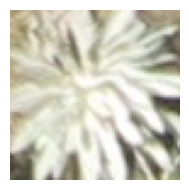

In [ ]:
def display_images(CE_x, num_images):
  image_shape = (70,70,3)
  num_images = min(num_images, len(CE_x))
  plt.figure(figsize=(160,2))

  plt.imshow(CE_x[num_images].reshape(image_shape))
  plt.axis('off')

  plt.tight_layout()
  plt.show()

display_images(CE_x,1)

In [ ]:
CE_x.shape

(175, 14700)

In [9]:
#Convertir X a un tensor con 4 dimensiones (número_de_imágenes, altura, ancho, canales)
CE_x = CE_x.reshape(CE_x.shape[0], 70, 70, 3)
CE_x = tf.convert_to_tensor(CE_x)

In [ ]:
CE_x.shape

TensorShape([175, 70, 70, 3])

In [ ]:
CE_y.shape

(175, 1)

# Pretrained Models from Keras

In [ ]:
import tensorflow as tf
tf.keras.backend.clear_session()

In [10]:
images = CE_x
images_resized = []
for image in images:
  resized_image = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(image)
  images_resized.append(resized_image)

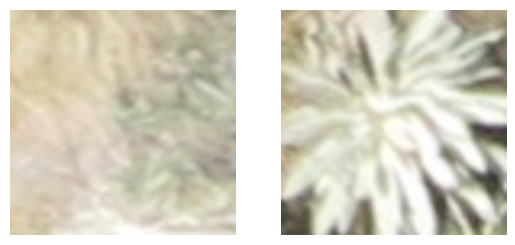

In [ ]:
# extra code – displays the cropped and resized images

#plt.figure(figsize=(10, 6))
for idx in (0,1):
    plt.subplot(1, 2, idx + 1)
    plt.imshow(images_resized[idx])
    plt.axis("off")

plt.show()

In [11]:
# Convert the list of images to a tensor
images_resized = tf.convert_to_tensor(images_resized)

# Preprocess the images
images_resized = tf.keras.applications.resnet50.preprocess_input(images_resized)
#inputs = tf.keras.applications.resnet50.preprocess_input(images_resized)

In [ ]:
model = tf.keras.applications.ResNet50(weights="imagenet")

102967424/102967424 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
Y_proba = model.predict(images_resized)
Y_proba.shape

6/6 ━━━━━━━━━━━━━━━━━━━━ 8s 850ms/step


(175, 1000)

In [ ]:
top_K = tf.keras.applications.resnet50.decode_predictions(Y_proba, top=3)

35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 1us/step


Image #0


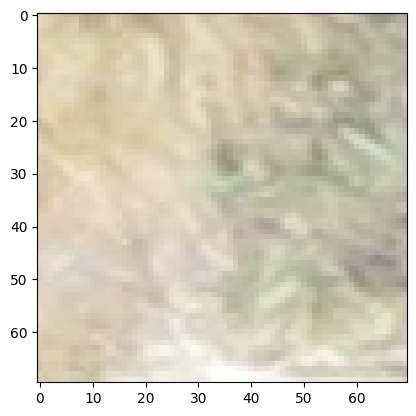

  n06359193 - web_site     7.40%
  n01930112 - nematode     5.63%
  n03196217 - digital_clock 4.42%
Image #1


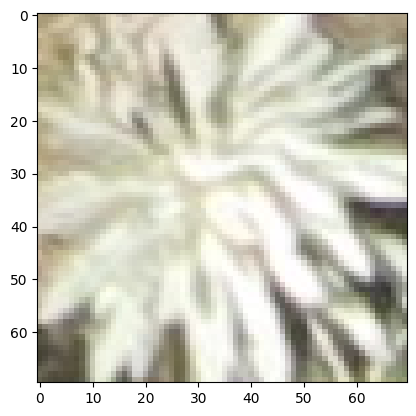

  n06359193 - web_site     6.13%
  n01930112 - nematode     5.26%
  n03196217 - digital_clock 4.72%


In [ ]:
for image_index in range(0, 2):
    print(f"Image #{image_index}")

    # Display the original image
    plt.imshow(images[image_index])
    plt.show()

    for class_id, name, y_proba in top_K[image_index]:
        print(f"  {class_id} - {name:12s} {y_proba:.2%}")

# Pretrained Models for Transfer Learning

In [ ]:
#tf.keras.backend.clear_session()  # extra code – resets layer name counter

In [12]:
#Realizamos el mismo pre-procesamiento en la data de test

CV_x = CV_x.reshape(CV_x.shape[0], 70, 70, 3)
CV_x = tf.convert_to_tensor(CV_x)
imagesV = CV_x
images_resizedV = []
for image in imagesV:
  resized_imageV = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(image)
  images_resizedV.append(resized_imageV)

# Convert the list of images to a tensor
images_resizedV = tf.convert_to_tensor(images_resizedV)

# Preprocess the images
images_resizedV = tf.keras.applications.resnet50.preprocess_input(images_resizedV)

In [13]:
#Creación trainset
batch_size = 32

labels = np.array(CE_y)  #array de etiquetas de entrenamiento
labels_tensor = tf.convert_to_tensor(labels, dtype=tf.int64)

train_set = tf.data.Dataset.from_tensor_slices((images_resized, labels))
train_set = train_set.shuffle(buffer_size=1000).batch(batch_size).prefetch(1)

In [14]:
#Creación valid_set
labelsV = np.array(CV_y)  #array de etiquetas de validación
labels_tensorV = tf.convert_to_tensor(labelsV, dtype=tf.int64)

valid_set = tf.data.Dataset.from_tensor_slices((images_resizedV, labelsV))
valid_set = valid_set.shuffle(buffer_size=1000).batch(batch_size).prefetch(1)

Data augmentations:

In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip(mode="horizontal", seed=42),
    tf.keras.layers.RandomRotation(factor=0.05, seed=42),
    tf.keras.layers.RandomContrast(factor=0.2, seed=42)
])

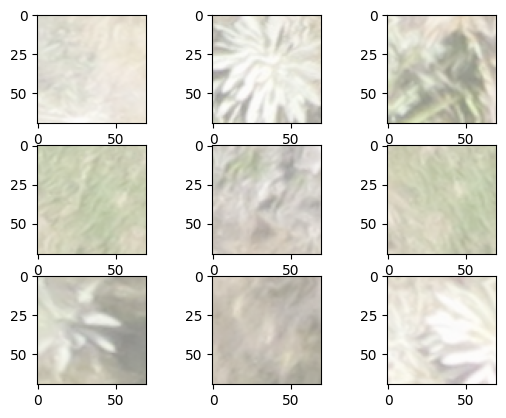

In [ ]:
# extra code – displays the same first 9 images, after augmentation

X_batch_augmented = data_augmentation(CE_x, training=True)
for index in range(9):
  plt.subplot(3, 3, index + 1)
  plt.imshow(np.clip((X_batch_augmented[index] + 1) / 2, 0, 1))
        # We must rescale the images to the 0-1 range for imshow(), and also
        # clip the result to that range, because data augmentation may
        # make some values go out of bounds (e.g., RandomContrast in this case).


plt.show()

In [ ]:
#Realizamos el mismo pre-procesamiento para la data aumentada

images = X_batch_augmented
images_resized = []
for image in images:
  resized_image = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(image)
  images_resized.append(resized_image)

# Convert the list of images to a tensor
images_resized = tf.convert_to_tensor(images_resized)

# Preprocess the images
images_resized = tf.keras.applications.resnet50.preprocess_input(images_resized)

Se carga el model pre-entranado sin las capas finales:

In [ ]:
# tf.random.set_seed(42)  # extra code – ensures reproducibility
# base_model = tf.keras.applications.xception.Xception(weights="imagenet", include_top=False)

In [15]:
tf.random.set_seed(42)  # extra code – ensures reproducibility
base_model = tf.keras.applications.ResNet50(weights="imagenet",include_top=False)

In [ ]:
base_model.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, None, None, 3)  │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, None, None, 3)  │              0 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, None, None, 64) │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, None, None, 64) │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, None, None, 64) │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, None, None, 64) │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, None, None, 64) │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, None, None, 64) │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, None, None, 64) │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, None, None, 64) │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, None, None, 64) │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, None, None, 64) │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, None, None, 64) │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, None, None,     │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │ 256)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, None, None,     │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 23,534,592 (89.78 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [16]:
avg = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
output = tf.keras.layers.Dense(1, activation="sigmoid")(avg)
model = tf.keras.Model(inputs=base_model.input, outputs=output)

for layer in base_model.layers:
    layer.trainable = False

#model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC()])

In [17]:
history = model.fit(train_set, validation_data=valid_set, epochs=20)

Epoch 1/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 33s 3s/step - auc: 0.5244 - loss: 0.7202 - val_auc: 0.4528 - val_loss: 0.6879
Epoch 2/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.5585 - loss: 0.7050 - val_auc: 0.4586 - val_loss: 0.6959
Epoch 3/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.4651 - loss: 0.6785 - val_auc: 0.4895 - val_loss: 0.6814
Epoch 4/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.5722 - loss: 0.6659 - val_auc: 0.5647 - val_loss: 0.6816
Epoch 5/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.4614 - loss: 0.6725 - val_auc: 0.5618 - val_loss: 0.6808
Epoch 6/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.5137 - loss: 0.6924 - val_auc: 0.5621 - val_loss: 0.6794
Epoch 7/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.4696 - loss: 0.6813 - val_auc: 0.5952 - val_loss: 0.6843
Epoch 8/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.5798 - loss: 0.6860 - val_auc: 0.6235 - val_loss: 0.6827
Epoch 9/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - auc: 0.5775 - loss: 0.6781 - val_auc: 

In [ ]:
for indices in zip(range(33), range(33, 66), range(66, 99), range(99, 132)):
    for idx in indices:
        print(f"{idx:3}: {base_model.layers[idx].name:22}", end="")
    print()

  0: input_layer            33: conv2_block3_2_bn      66: conv3_block3_2_relu    99: conv4_block2_3_conv   
  1: conv1_pad              34: conv2_block3_2_relu    67: conv3_block3_3_conv   100: conv4_block2_3_bn     
  2: conv1_conv             35: conv2_block3_3_conv    68: conv3_block3_3_bn     101: conv4_block2_add      
  3: conv1_bn               36: conv2_block3_3_bn      69: conv3_block3_add      102: conv4_block2_out      
  4: conv1_relu             37: conv2_block3_add       70: conv3_block3_out      103: conv4_block3_1_conv   
  5: pool1_pad              38: conv2_block3_out       71: conv3_block4_1_conv   104: conv4_block3_1_bn     
  6: pool1_pool             39: conv3_block1_1_conv    72: conv3_block4_1_bn     105: conv4_block3_1_relu   
  7: conv2_block1_1_conv    40: conv3_block1_1_bn      73: conv3_block4_1_relu   106: conv4_block3_2_conv   
  8: conv2_block1_1_bn      41: conv3_block1_1_relu    74: conv3_block4_2_conv   107: conv4_block3_2_bn     
  9: conv2_block1_1

Entrenar las últimas capas:

In [ ]:
for layer in base_model.layers[76:]:
    layer.trainable = True

optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
#model.compile(loss="binary_crossentropy", optimizer=optimizer,metrics=["accuracy"])
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC()])
history = model.fit(train_set, validation_data=valid_set, epochs=5)

Epoch 1/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 40s 3s/step - auc_2: 0.8897 - loss: 0.4015 - val_auc_2: 0.7020 - val_loss: 1.4479
Epoch 2/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 17s 193ms/step - auc_2: 0.9268 - loss: 0.3773 - val_auc_2: 0.5469 - val_loss: 2.0247
Epoch 3/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 188ms/step - auc_2: 0.8761 - loss: 0.4465 - val_auc_2: 0.5000 - val_loss: 5.6113
Epoch 4/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 194ms/step - auc_2: 0.9339 - loss: 0.3319 - val_auc_2: 0.5000 - val_loss: 14.3457
Epoch 5/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 217ms/step - auc_2: 0.9315 - loss: 0.4367 - val_auc_2: 0.5156 - val_loss: 2.6162


In [ ]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = model.evaluate(train_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 349ms/step - auc_6: 0.8868 - loss: 1.0228

compile_metrics: 87.70%


In [ ]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = model.evaluate(valid_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - auc_6: 0.8797 - loss: 0.8362

compile_metrics: 89.53%


In [18]:
for layer in base_model.layers[56:]:
    layer.trainable = True

optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
#model.compile(loss="binary_crossentropy", optimizer=optimizer,metrics=["accuracy"])
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC()])
history = model.fit(train_set, validation_data=valid_set, epochs=20)

Epoch 1/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 73s 7s/step - auc_1: 0.4653 - loss: 0.7586 - val_auc_1: 0.6682 - val_loss: 0.6944
Epoch 2/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 34s 6s/step - auc_1: 0.7222 - loss: 0.7506 - val_auc_1: 0.7475 - val_loss: 0.9590
Epoch 3/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 35s 6s/step - auc_1: 0.8648 - loss: 0.4687 - val_auc_1: 0.7162 - val_loss: 1.0414
Epoch 4/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 37s 6s/step - auc_1: 0.9049 - loss: 0.4822 - val_auc_1: 0.5948 - val_loss: 0.7593
Epoch 5/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 37s 6s/step - auc_1: 0.9551 - loss: 0.2882 - val_auc_1: 0.6871 - val_loss: 0.8142
Epoch 6/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 36s 6s/step - auc_1: 0.9752 - loss: 0.2196 - val_auc_1: 0.8419 - val_loss: 0.8002
Epoch 7/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 36s 6s/step - auc_1: 0.9875 - loss: 0.1943 - val_auc_1: 0.8685 - val_loss: 0.9226
Epoch 8/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 35s 6s/step - auc_1: 0.9965 - loss: 0.1048 - val_auc_1: 0.7998 - val_loss: 1.5295
Epoch 9/20
6/6 ━━━━━━━━━━━━━━━━━━━━ 35s 6s/step - auc_1:

In [20]:
#Evaluación del modelo en train
scores = model.evaluate(train_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - auc_1: 0.9551 - loss: 0.3946

compile_metrics: 95.53%


In [21]:
#Evaluación del modelo en test
scores = model.evaluate(valid_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 1s/step - auc_1: 0.9277 - loss: 0.6841

compile_metrics: 92.30%


In [19]:
model.save('modelo_Restnet50.h5')

Uso de optuna

In [ ]:
pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.0/233.0 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 7.3 MB/s eta 0:00:00


In [ ]:
import optuna
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
from tensorflow.keras.regularizers import l2

def objective(trial):

    # Hiperparámetros a sintonizar
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    optimizer_name = trial.suggest_categorical('optimizer', ['adam', 'rmsprop', 'sgd'])
    n_trainable_layers = trial.suggest_int('n_trainable_layers', 1, 50)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
    n_units = trial.suggest_int('n_units', 64, 512)
    l2_reg = trial.suggest_loguniform('l2_reg', 1e-6, 1e-2)

    # Cargar el modelo base ResNet50 preentrenado
    base_model = ResNet50(input_shape=(224, 224, 3), include_top=False, weights='imagenet')

    # Hacer que las primeras n capas sean entrenables
    for layer in base_model.layers[:n_trainable_layers]:
        layer.trainable = True

    # Congelar el resto de capas
    for layer in base_model.layers[n_trainable_layers:]:
        layer.trainable = False

    # Construir el modelo
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(n_units, activation='relu', kernel_regularizer=l2(l2_reg))(x)
    x = Dropout(dropout_rate)(x)
    output = Dense(1, activation='sigmoid')(x)

    model = Model(inputs=base_model.input, outputs=output)

    # Selección del optimizador
    if optimizer_name == 'adam':
        optimizer = Adam(learning_rate=learning_rate)
    elif optimizer_name == 'rmsprop':
        optimizer = RMSprop(learning_rate=learning_rate)
    else:
        optimizer = SGD(learning_rate=learning_rate)

    # Compilar el modelo
    #model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC()])

    # Entrenar el modelo (aquí debes usar tus propios datos)
    history = model.fit(train_set, validation_data=valid_set, epochs=10, batch_size=32)

    # Evaluar el modelo
    score = model.evaluate(valid_set)

    # Devuelve la precisión de validación para que Optuna la maximice
    return score[1]

In [ ]:
# Ejecutar la optimización
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)

print("Best trial:")
trial = study.best_trial
print("  Value: {}".format(trial.value))
print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2024-09-03 17:09:47,512] A new study created in memory with name: no-name-93f2ddbc-2c35-4a82-9071-07af52e4c038
<ipython-input-38-aa188814e3ec>:12: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
<ipython-input-38-aa188814e3ec>:15: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
<ipython-input-38-aa188814e3ec>:17: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  l2_reg = trial.suggest_loguniform('l2_reg'

Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - auc_15: 0.4753 - loss: 0.7623 - val_auc_15: 0.5676 - val_loss: 0.6991
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 202ms/step - auc_15: 0.4953 - loss: 0.7335 - val_auc_15: 0.4942 - val_loss: 0.6966
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 224ms/step - auc_15: 0.5214 - loss: 0.7099 - val_auc_15: 0.5988 - val_loss: 0.6961
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 232ms/step - auc_15: 0.4706 - loss: 0.7404 - val_auc_15: 0.6036 - val_loss: 0.6975
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 207ms/step - auc_15: 0.5881 - loss: 0.6692 - val_auc_15: 0.6497 - val_loss: 0.7014
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 206ms/step - auc_15: 0.7093 - loss: 0.6349 - val_auc_15: 0.7089 - val_loss: 0.6962
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 207ms/step - auc_15: 0.6388 - loss: 0.6628 - val_auc_15: 0.7126 - val_loss: 0.6994
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 208ms/step - auc_15: 0.5873 - loss: 0.6614 - val_auc_15: 0.7209 - val_loss: 0.6935
Epoch 9/10
6/6 ━━━━━━━━━━━

[I 2024-09-03 17:10:20,339] Trial 0 finished with value: 0.754723846912384 and parameters: {'learning_rate': 0.001268135475682441, 'optimizer': 'sgd', 'n_trainable_layers': 5, 'dropout_rate': 0.21796769322325316, 'n_units': 300, 'l2_reg': 2.3913681564542685e-05}. Best is trial 0 with value: 0.754723846912384.


Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 24s 3s/step - auc_16: 0.5026 - loss: 1.3854 - val_auc_16: 0.4771 - val_loss: 1.2433
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 242ms/step - auc_16: 0.7274 - loss: 1.1347 - val_auc_16: 0.6435 - val_loss: 1.2374
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 222ms/step - auc_16: 0.6820 - loss: 1.1560 - val_auc_16: 0.7504 - val_loss: 1.2245
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 240ms/step - auc_16: 0.7490 - loss: 1.1136 - val_auc_16: 0.7049 - val_loss: 1.2290
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 219ms/step - auc_16: 0.7456 - loss: 1.1081 - val_auc_16: 0.6159 - val_loss: 1.2240
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 222ms/step - auc_16: 0.7095 - loss: 1.1379 - val_auc_16: 0.5491 - val_loss: 1.2167
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 221ms/step - auc_16: 0.7569 - loss: 1.1216 - val_auc_16: 0.6512 - val_loss: 1.2201
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 244ms/step - auc_16: 0.7788 - loss: 1.0774 - val_auc_16: 0.6203 - val_loss: 1.2187
Epoch 9/10
6/6 ━━━━━━━━━━━

[I 2024-09-03 17:11:06,035] Trial 1 finished with value: 0.5232558250427246 and parameters: {'learning_rate': 0.00045446876739879926, 'optimizer': 'sgd', 'n_trainable_layers': 26, 'dropout_rate': 0.18492453995887215, 'n_units': 114, 'l2_reg': 0.0023980907077977122}. Best is trial 0 with value: 0.754723846912384.


Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 26s 3s/step - auc_17: 0.5242 - loss: 2.0106 - val_auc_17: 0.3583 - val_loss: 1.8242
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 20s 228ms/step - auc_17: 0.5485 - loss: 1.9146 - val_auc_17: 0.3768 - val_loss: 1.7886
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 234ms/step - auc_17: 0.5683 - loss: 1.8817 - val_auc_17: 0.3677 - val_loss: 1.7777
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 230ms/step - auc_17: 0.5241 - loss: 1.8927 - val_auc_17: 0.4077 - val_loss: 1.7801
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 231ms/step - auc_17: 0.5783 - loss: 1.8593 - val_auc_17: 0.5000 - val_loss: 1.7627
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 235ms/step - auc_17: 0.5231 - loss: 1.8853 - val_auc_17: 0.5363 - val_loss: 1.7572
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 252ms/step - auc_17: 0.5138 - loss: 1.8852 - val_auc_17: 0.5265 - val_loss: 1.7542
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 258ms/step - auc_17: 0.5012 - loss: 1.8726 - val_auc_17: 0.5349 - val_loss: 1.7508
Epoch 9/10
6/6 ━━━━━━━━━━

[I 2024-09-03 17:12:10,785] Trial 2 finished with value: 0.6682412624359131 and parameters: {'learning_rate': 1.0388711111168925e-05, 'optimizer': 'sgd', 'n_trainable_layers': 43, 'dropout_rate': 0.4272219984031992, 'n_units': 192, 'l2_reg': 0.0029412918011281273}. Best is trial 0 with value: 0.754723846912384.


Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 34s 3s/step - auc_18: 0.5337 - loss: 1.3013 - val_auc_18: 0.4895 - val_loss: 0.8070
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 18s 230ms/step - auc_18: 0.7795 - loss: 0.6779 - val_auc_18: 0.3463 - val_loss: 0.7892
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 232ms/step - auc_18: 0.7542 - loss: 0.7790 - val_auc_18: 0.6032 - val_loss: 0.7866
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 254ms/step - auc_18: 0.8391 - loss: 0.6111 - val_auc_18: 0.6584 - val_loss: 0.7874
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 238ms/step - auc_18: 0.8679 - loss: 0.5457 - val_auc_18: 0.6508 - val_loss: 0.8015
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 233ms/step - auc_18: 0.7596 - loss: 0.7787 - val_auc_18: 0.5494 - val_loss: 0.7873
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 233ms/step - auc_18: 0.9648 - loss: 0.3841 - val_auc_18: 0.5040 - val_loss: 0.9210
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 237ms/step - auc_18: 0.8569 - loss: 0.6761 - val_auc_18: 0.5000 - val_loss: 0.8452
Epoch 9/10
6/6 ━━━━━━━━━━

[I 2024-09-03 17:13:18,703] Trial 3 finished with value: 0.5 and parameters: {'learning_rate': 0.0005729381634387246, 'optimizer': 'rmsprop', 'n_trainable_layers': 41, 'dropout_rate': 0.15416777391269001, 'n_units': 169, 'l2_reg': 0.0003345658179359302}. Best is trial 0 with value: 0.754723846912384.


Epoch 1/10


In [ ]:
# Recuperar los mejores hiperparámetros del best_trial
best_trial = study.best_trial
best_trial

FrozenTrial(number=3, state=TrialState.COMPLETE, values=[0.5944767594337463], datetime_start=datetime.datetime(2024, 9, 3, 16, 45, 22, 932890), datetime_complete=datetime.datetime(2024, 9, 3, 16, 46, 10, 638348), params={'learning_rate': 0.007226789315139722, 'optimizer': 'sgd', 'n_trainable_layers': 48, 'dropout_rate': 0.4353590292333308, 'n_units': 354, 'l2_reg': 6.639950423326925e-06}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'learning_rate': FloatDistribution(high=0.01, log=True, low=1e-05, step=None), 'optimizer': CategoricalDistribution(choices=('adam', 'rmsprop', 'sgd')), 'n_trainable_layers': IntDistribution(high=50, log=False, low=1, step=1), 'dropout_rate': FloatDistribution(high=0.5, log=False, low=0.1, step=None), 'n_units': IntDistribution(high=512, log=False, low=64, step=1), 'l2_reg': FloatDistribution(high=0.01, log=True, low=1e-06, step=None)}, trial_id=3, value=None)

In [ ]:
# Obtener los mejores hiperparámetros del best_trial
n_trainable_layers = best_trial.params['n_trainable_layers']
dropout_rate = best_trial.params['dropout_rate']
n_units = best_trial.params['n_units']
l2_reg = best_trial.params['l2_reg']
optimizer_name = best_trial.params['optimizer']
learning_rate = best_trial.params['learning_rate']

# Cargar el modelo base ResNet50 preentrenado
base_model = ResNet50(input_shape=(224, 224, 3), include_top=False, weights='imagenet')

# Hacer que las primeras n capas sean entrenables
for layer in base_model.layers[:n_trainable_layers]:
    layer.trainable = True

 # Congelar el resto de capas
for layer in base_model.layers[n_trainable_layers:]:
    layer.trainable = False

# Construir el modelo
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(n_units, activation='relu', kernel_regularizer=l2(l2_reg))(x)
x = Dropout(dropout_rate)(x)
output = Dense(1, activation='sigmoid')(x)

model = Model(inputs=base_model.input, outputs=output)

# Selección del optimizador
if optimizer_name == 'adam':
    optimizer = Adam(learning_rate=learning_rate)
elif optimizer_name == 'rmsprop':
    optimizer = RMSprop(learning_rate=learning_rate)
elif optimizer_name == 'sgd':
    optimizer = SGD(learning_rate=learning_rate)

# Compilar el modelo
#model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=[tf.keras.metrics.AUC()])

# Entrenar el modelo
history = model.fit(train_set, validation_data=valid_set, epochs=10, batch_size=32)

# Entrenar modelo final con los datos de entrenamiento:
model.compile( optimizer=optimizer,  loss='binary_crossentropy',  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
history = model.fit(train_set, validation_data=valid_set, epochs=10, batch_size=32,callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, mode='min')])

Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step - auc_14: 0.4789 - loss: 0.8602 - val_auc_14: 0.4531 - val_loss: 0.7088
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 252ms/step - auc_14: 0.5838 - loss: 0.6909 - val_auc_14: 0.5447 - val_loss: 0.7231
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 240ms/step - auc_14: 0.7599 - loss: 0.5900 - val_auc_14: 0.6007 - val_loss: 0.6954
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 240ms/step - auc_14: 0.8446 - loss: 0.4871 - val_auc_14: 0.4953 - val_loss: 0.6883
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 236ms/step - auc_14: 0.8942 - loss: 0.4447 - val_auc_14: 0.3161 - val_loss: 0.6883
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 235ms/step - auc_14: 0.9298 - loss: 0.3541 - val_auc_14: 0.3125 - val_loss: 0.7131
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 235ms/step - auc_14: 0.6080 - loss: 0.9169 - val_auc_14: 0.2700 - val_loss: 0.6967
Epoch 8/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 235ms/step - auc_14: 0.7355 - loss: 0.6094 - val_auc_14: 0.1722 - val_loss: 0.6992
Epoch 9/10
6/6 ━━━━━━━━━━━

In [ ]:
#Evaluación del modelo en train
scores = model.evaluate(train_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 3s 580ms/step - accuracy: 0.6101 - auc: 0.3959 - loss: 0.8303

compile_metrics: 58.29%


In [ ]:
#Evaluación del modelo en test
scores = model.evaluate(valid_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - accuracy: 0.6226 - auc: 0.4432 - loss: 0.8092

compile_metrics: 57.33%


No se obtiene un mejor resultado con los parámetros seleccionados a partir de optuna, por lo que utilizamos para la predicción el modelo que tuvo un AUC en validación del 92,72%

Prueba Cualitativa del modelo

In [8]:
from tensorflow.keras.models import load_model
import numpy as np
import tensorflow as tf

model = tf.keras.models.load_model('modelo_Restnet50.h5')
import urllib
import matplotlib.pyplot as plt

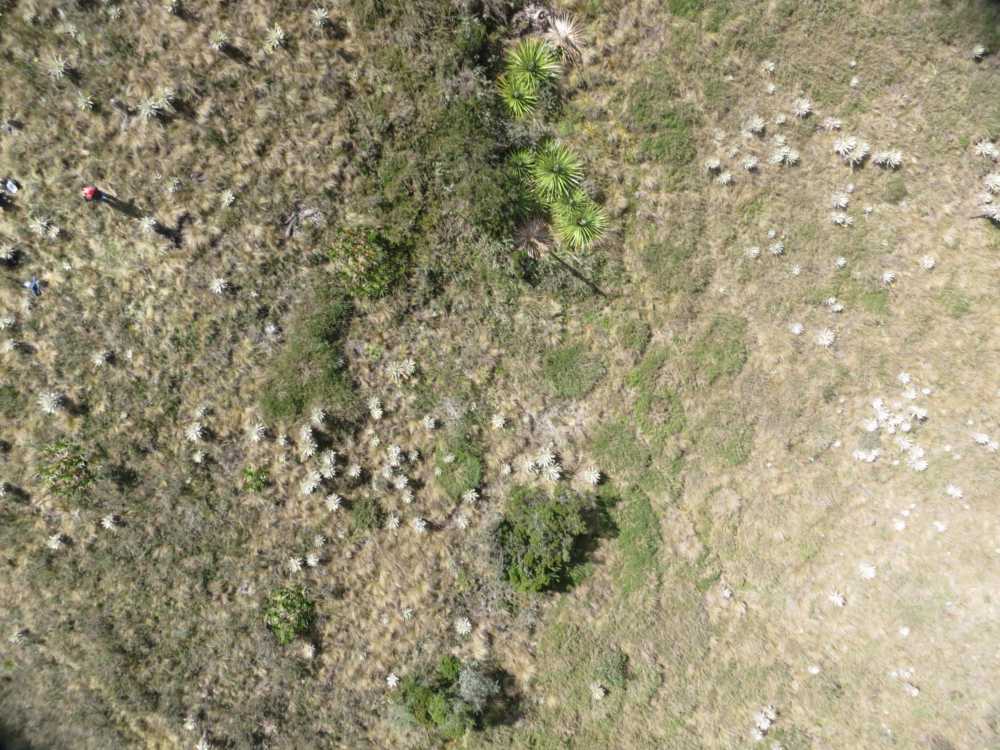

In [22]:
from tensorflow.keras.utils import load_img # import load_img from the correct module

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [23]:
from sklearn.metrics import precision_recall_curve, roc_curve, f1_score

y_pred_prob = model.predict(images_resized)


# Calcular TPR y FPR para la curva ROC
fpr, tpr, thresholds = roc_curve(CE_y, y_pred_prob)

# Calcular Precision, Recall y Thresholds para la curva Precision-Recall
precision, recall, thresholds_pr = precision_recall_curve(CE_y, y_pred_prob)

# Calcular F1-Score para diferentes umbrales
f1_scores = [f1_score(CE_y, y_pred_prob >= thr) for thr in thresholds]

# Encontrar el umbral que maximiza el F1-Score
best_threshold = thresholds[np.argmax(f1_scores)]
print('Best Threshold:', best_threshold)

6/6 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step
Best Threshold: 0.483843


In [24]:
#Matriz de confusión para diferentes umbrales
import numpy as np
from sklearn.metrics import confusion_matrix, f1_score, precision_score, recall_score

thresholds = [0.02,0.1, 0.5, 0.9]
for thr in thresholds:
    y_pred = (y_pred_prob >= thr).astype(int)
    print(f'Umbral: {thr}')
    print(f'Precisión: {precision_score(CE_y, y_pred):.4f}')
    print(f'Recall: {recall_score(CE_y, y_pred):.4f}')
    print(f'F1-Score: {f1_score(CE_y, y_pred):.4f}')
    print(f'Matriz de Confusión: \n{confusion_matrix(CE_y, y_pred)}\n')

Umbral: 0.02
Precisión: 0.8023
Recall: 0.9452
F1-Score: 0.8679
Matriz de Confusión: 
[[85 17]
 [ 4 69]]

Umbral: 0.1
Precisión: 0.8500
Recall: 0.9315
F1-Score: 0.8889
Matriz de Confusión: 
[[90 12]
 [ 5 68]]

Umbral: 0.5
Precisión: 0.9155
Recall: 0.8904
F1-Score: 0.9028
Matriz de Confusión: 
[[96  6]
 [ 8 65]]

Umbral: 0.9
Precisión: 0.9242
Recall: 0.8356
F1-Score: 0.8777
Matriz de Confusión: 
[[97  5]
 [12 61]]



Imagen con las predicciones:

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


C:\Users\Acer\AppData\Local\Temp\ipykernel_32400\782868974.py:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_P = int(model.predict(vec) > 0.98)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━

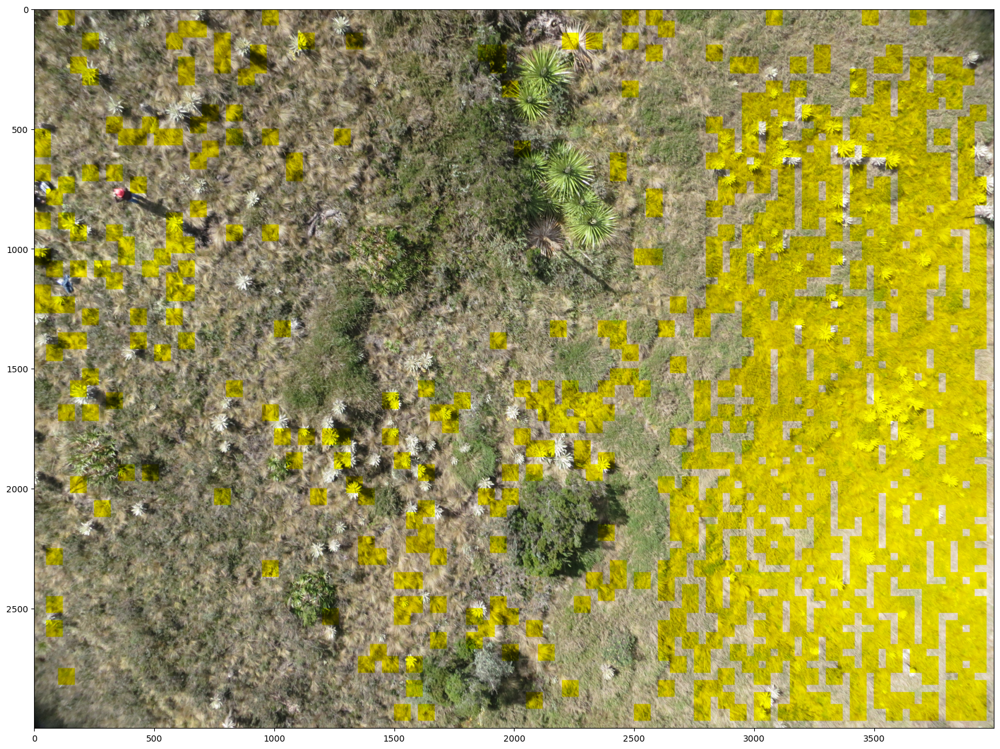

In [31]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        #subi=x[f1:f2,c1:c2,]
        #subi2=np.ndarray.flatten(subi).T/255.
        # ns=subi2.shape[0]
        vec=x[f1:f2,c1:c2,]

        vec = vec.reshape(1, 70, 70, 3)
        vec = tf.convert_to_tensor(vec)
        vec = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(vec)
        vec = tf.convert_to_tensor(vec)
        vec = tf.keras.applications.resnet50.preprocess_input(vec)
        #vec = tf.expand_dims(vec, axis=0)

        pred_P = int(model.predict(vec) > 0.98)
        #pred_P= red_neu.predict(vec.T)
        #pred_P=pred(param, vec)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50

plt.figure(figsize = (20,20))
plt.imshow(x2)